This notebook contains a number of visualizations pertaining to naive cleaning techniques for polluted event logs and their effects on remaining time prediction.

# SETUP

##Imports

In [ ]:
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import time
import statistics
import pickle

%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

In [ ]:
pollution_types = ["DISTORTED", "POLLUTED.NORND", "POLLUTED.RANDOM"]
techniques = ["levenshtein-1", "levenshtein-5", "DROP-0.001", "DROP_DELETE-0.001"]
percentages = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
dq = ["DISTINCT", "UNIQUENESS", "CONSTANCY"]
scorings = ["accuracy", "f1"]
metrics = dq+scorings
metrics_time = metrics + ["time"]
metrics_training = ["test_loss", "test_mae", "time"]
metrics_eval = ["mae", "time"]

## Functions

In [ ]:
def time_spread(dataset):
  df = pd.read_csv(f'./{dataset}/{dataset}/{dataset}_prepared/{dataset}-TRAIN-CLEAN.csv')
  df_test = pd.read_csv(f'./{dataset}/{dataset}/{dataset}-TEST-CLEAN.csv')

  combined_df = pd.DataFrame({
      'TRAIN': df['DATAEV'],
      'TEST': df_test['DATAEV']
  })

  fig = px.histogram(combined_df, x=["TRAIN", "TEST"])
  fig.update_layout(bargap=0.2, barmode='overlay')
  fig.show()

In [ ]:
colors = ["red", "blue", "orange"] #TODO: find better colors

def summary_stats_plot(metrics, dq_dict_avg, scores_matrix_avg, cleaning_type="levenshtein", d=1, dataset="BPIC11"):
  n = len(metrics)
  fig, axes = plt.subplots(2, 3, figsize=(25, 15)) #tentative
  axes = axes.flatten()

  x = percentages
  j=0
  for i, metric in enumerate(metrics):

    if metric!="time": # first part only for uncleaned datasets, which do not have an associated cleaning time
      y = [dq_dict_avg["CLEAN"][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')
      for pollution_type in pollution_types: # base datasets
        y = [dq_dict_avg[pollution_type][percentage][metric] for percentage in percentages]
        axes[i].plot(x, y, linestyle="dashed", marker="o", label=pollution_type, linewidth=3, color=colors[j%len(colors)])
        j+=1

    for pollution_type in pollution_types: # cleaned datasets
      y = [scores_matrix_avg[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label='CLEANED ' + pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

    axes[i].set_xlabel("Corruption percentage")
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary statistics of dataset {dataset} before and after cleaning with {cleaning_type} (d={d}) technique", y=1)
  fig.tight_layout()
  fig.show()

In [ ]:
#colors_pol = ["orange", "lightblue", "orange"]

def summary_stats_plot_by_pollution(metrics, dq_dict_avg, scores_matrix_avg, pollution_type="DISTORTED", dataset="BPIC11"):

  fig, axes = plt.subplots(2, 3, figsize=(25, 15)) #tentative
  axes = axes.flatten()

  x = percentages

  for i, metric in enumerate(metrics):
    for j in range(len(techniques)-1): # -1 to ignore DROP_DELETE here
      y = [scores[j][pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label=techniques[j], linewidth=3, color=colors[j%len(colors)])

    if metric!="time": # first part only for uncleaned datasets, which do not have an associated cleaned time
      axes[i].plot(x, [dq_dict_avg[pollution_type][percentage][metric] for percentage in percentages], linestyle="dashed", marker="o", label="DIRTY", linewidth=3, color='brown')

    axes[i].set_xlabel("Corruption percentage")
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary statistics of dataset {dataset} with {pollution_type} pollution before and after cleaning with different techniques", y=1)
  fig.tight_layout()
  fig.show()

In [ ]:
def summary_stats_plot_training(metrics, scores_reference, scores_dirty, scores_matrix_avg, cleaning_type="levenshtein", d=1, dataset="BPIC11"):
  n = len(metrics)
  fig, axes = plt.subplots(1, 3, figsize=(15, 15)) #tentative
  axes = axes.flatten()

  x = percentages
  j=0
  for i, metric in enumerate(metrics):
    y = [scores_dirty['CLEAN'][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')

    for pollution_type in pollution_types: # dirty datasets
      y = [scores_dirty[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="dashed", marker="o", label=pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

    for pollution_type in pollution_types: # cleaned datasets
      y = [scores_matrix_avg[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label='CLEANED ' + pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

    axes[i].set_xlabel("Corruption percentage")
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary training statistics of dataset {dataset} before and after cleaning with {cleaning_type} (d={d}) technique", y=1)
  fig.tight_layout()
  fig.show()

In [ ]:
#colors_pol2 = ["lightblue", "blue", "orange", "black"]

def summary_stats_plot_training_by_pollution(metrics, scores_reference, scores_dirty, scores_matrix_avg, pollution_type="DISTORTED", dataset="BPIC11"):

  fig, axes = plt.subplots(1, 3, figsize=(15, 15)) #tentative
  axes = axes.flatten()

  x = percentages

  for i, metric in enumerate(metrics):

    # Original
    y = [scores_reference["CLEAN"][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')

    # Not cleaned
    y = [scores_dirty[pollution_type][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="corrupted", linewidth=3, color='red')

    # Cleaned
    for j in range(len(techniques)):
      y = [scores_matrix_avg[j][pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label=techniques[j], color=colors[j%len(colors)])

    axes[i].set_xlabel("Corruption percentage")
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary training statistics of dataset {dataset} with {pollution_type} pollution before and after cleaning with different techniques", y=1)
  fig.tight_layout()
  fig.show()

In [ ]:
# Exactly the same as training
def summary_stats_plot_eval(metrics, scores_reference, scores_dirty, scores_matrix_avg, cleaning_type="levenshtein", d=1, dataset="BPIC11"):
  n = len(metrics)
  fig, axes = plt.subplots(1, 2, figsize=(15, 10)) #tentative
  axes = axes.flatten()

  x = percentages
  j=0

  for i, metric in enumerate(metrics):

    y = [scores_dirty['CLEAN'][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')

    for pollution_type in pollution_types: # dirty datasets
      y = [scores_dirty[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="dashed", marker="o", label=pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

    for pollution_type in pollution_types: # cleaned datasets
      y = [scores_matrix_avg[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label='CLEANED ' + pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

    axes[i].set_xlabel("Corruption percentage")
    if metric=="mae":
      metric = "mae (days)"
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary training statistics of dataset {dataset} before and after cleaning with {cleaning_type} (d={d}) technique", y=1)
  fig.tight_layout()
  fig.show()

In [ ]:
# Exactly the same as training
def summary_stats_plot_eval_by_pollution(metrics, scores_reference, scores_dirty, scores_matrix_avg, pollution_type="DISTORTED", dataset="BPIC11"):

  fig, axes = plt.subplots(1, 2, figsize=(15, 10)) #tentative
  axes = axes.flatten()

  x = percentages

  for i, metric in enumerate(metrics):

    # Original
    y = [scores_reference["CLEAN"][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')

    # Not cleaned
    y = [scores_dirty[pollution_type][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="corrupted", linewidth=3, color='red')

    # Cleaned
    for j in range(len(techniques)):
      y = [scores_matrix_avg[j][pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label=techniques[j], linewidth=3, color=colors[j%len(colors)])

    y = [scores_matrix_avg[-1][0.05]['mae'] for percentage in percentages] # emptied labels
    axes[i].plot(x, y, linestyle="-", marker="o", label='emptied labels', linewidth=3, color="gray")

    axes[i].set_xlabel("Corruption percentage")
    if metric=="mae":
      metric = "mae (days)"
    axes[i].set_ylabel(metric)
    axes[i].set_title(f"{metric} in {dataset}")
    axes[i].legend()
    axes[i].grid(True)

  fig.suptitle(f"Summary training statistics of dataset {dataset} with {pollution_type} pollution before and after cleaning with different techniques", y=1)
  fig.tight_layout()
  fig.show()

# BPIC11

In [ ]:
dataset = "BPIC11_f1"

In [ ]:
time_spread(dataset)

# CLEANING

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pickle', 'rb') as f:
  ref = pickle.load(f)
scores = []
for technique in techniques:
  with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_avg.pickle', 'rb') as f:
    scores.append(pickle.load(f))

## By cleaning technique

### Levenshtein-1

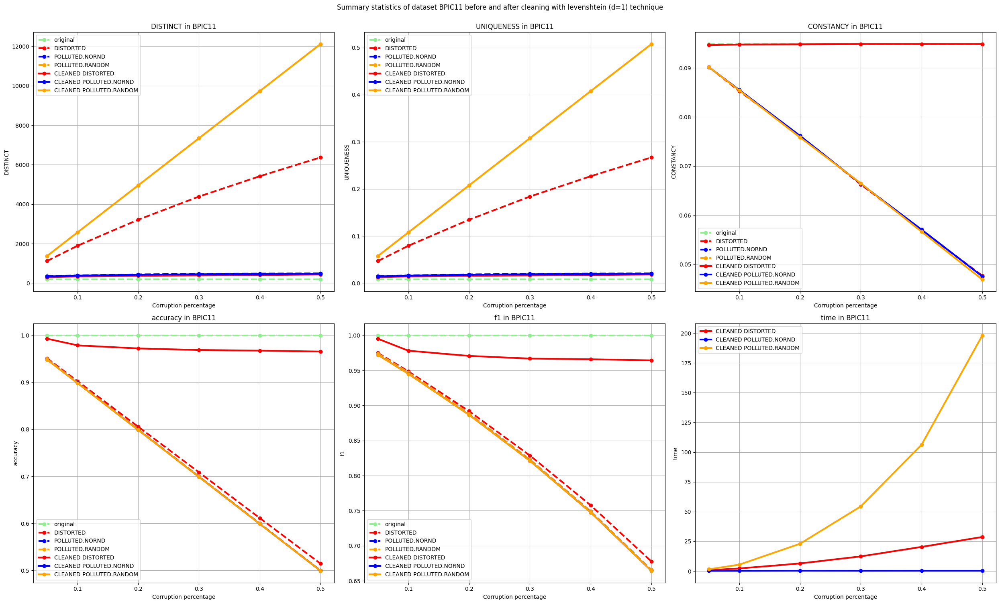

In [ ]:
summary_stats_plot(metrics_time, ref, scores[0], cleaning_type="levenshtein", d=1, dataset="BPIC11")

###Levenshtein-5

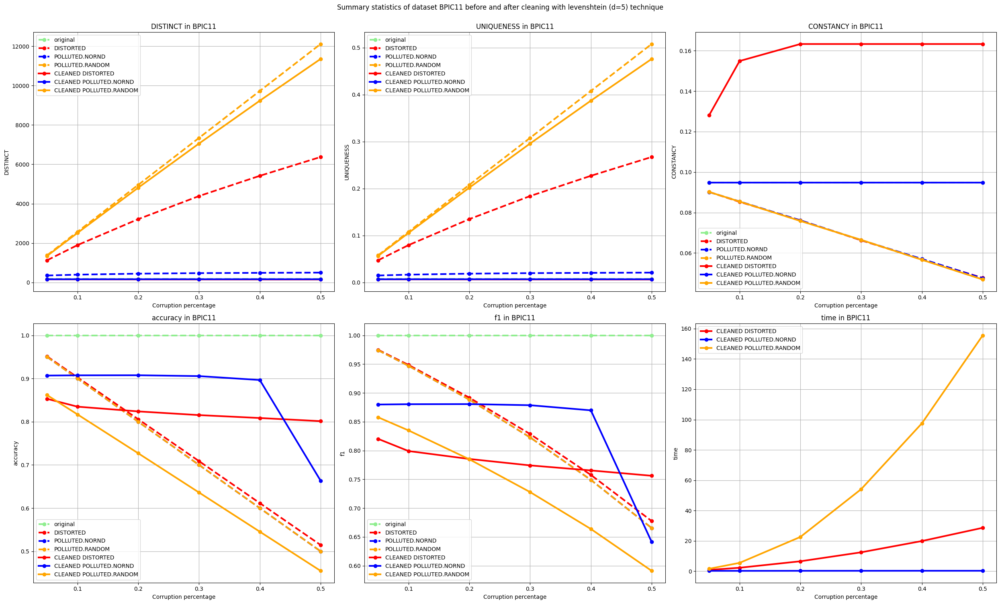

In [ ]:
summary_stats_plot(metrics_time, ref ,scores[1], cleaning_type="levenshtein", d=5, dataset="BPIC11")

### DROP-0.001

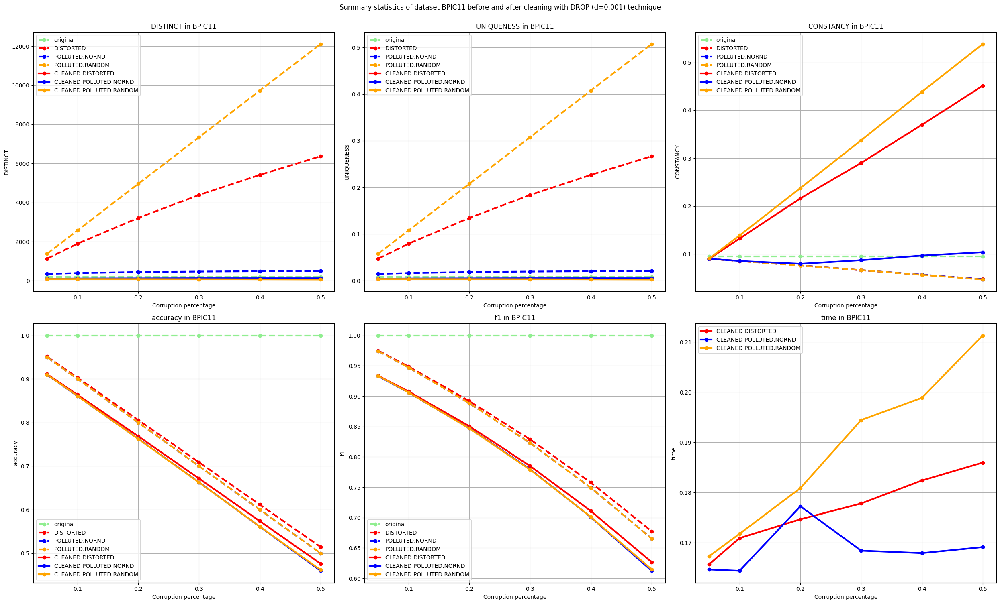

In [ ]:
summary_stats_plot(metrics_time, ref, scores[2], cleaning_type="DROP", d=0.001, dataset="BPIC11")

##By pollution type

### DISTORTED

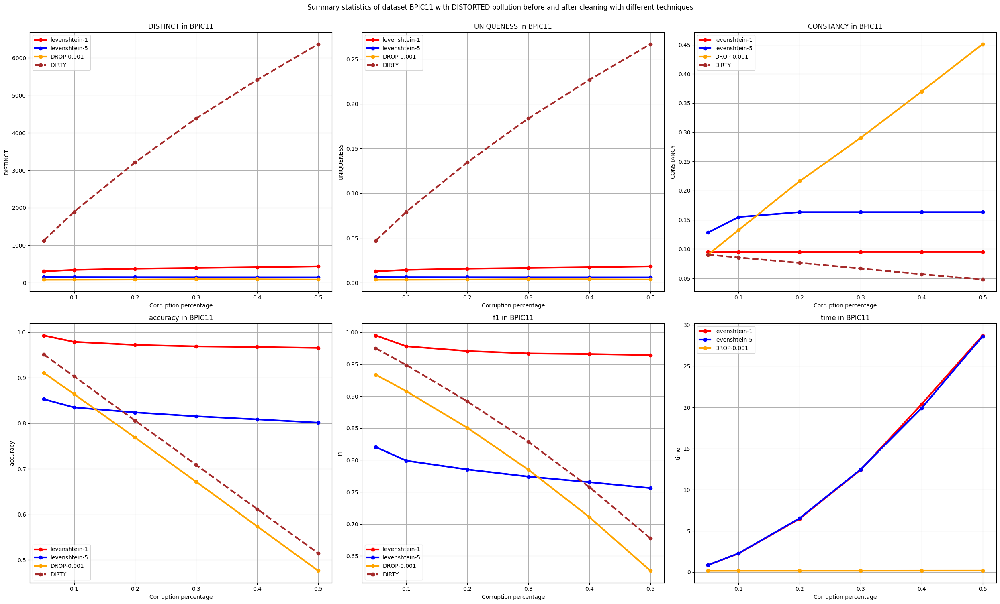

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="DISTORTED", dataset="BPIC11")

### POLLUTED.NORND

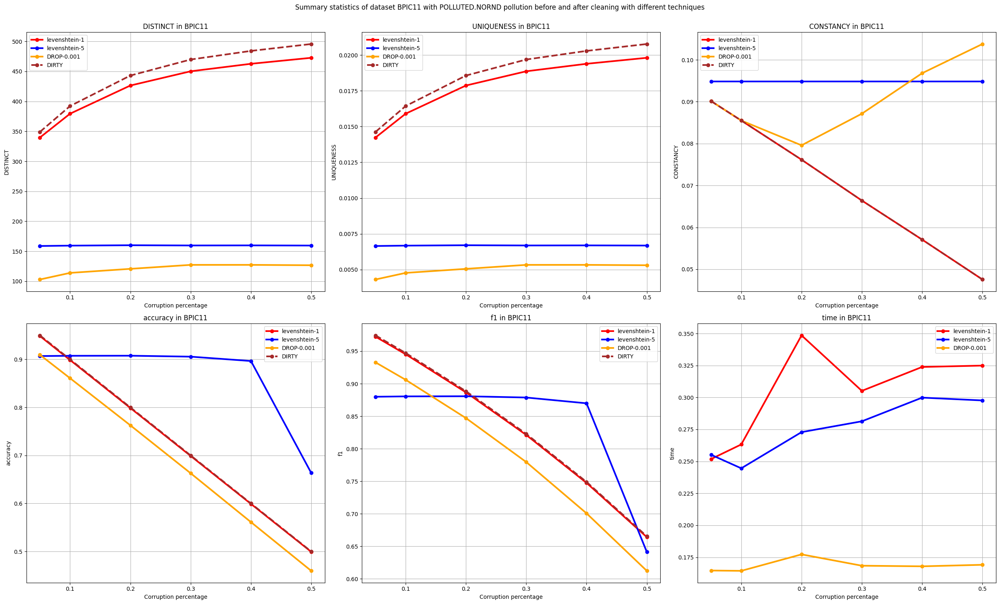

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="POLLUTED.NORND", dataset="BPIC11")

###POLLUTED.RANDOM

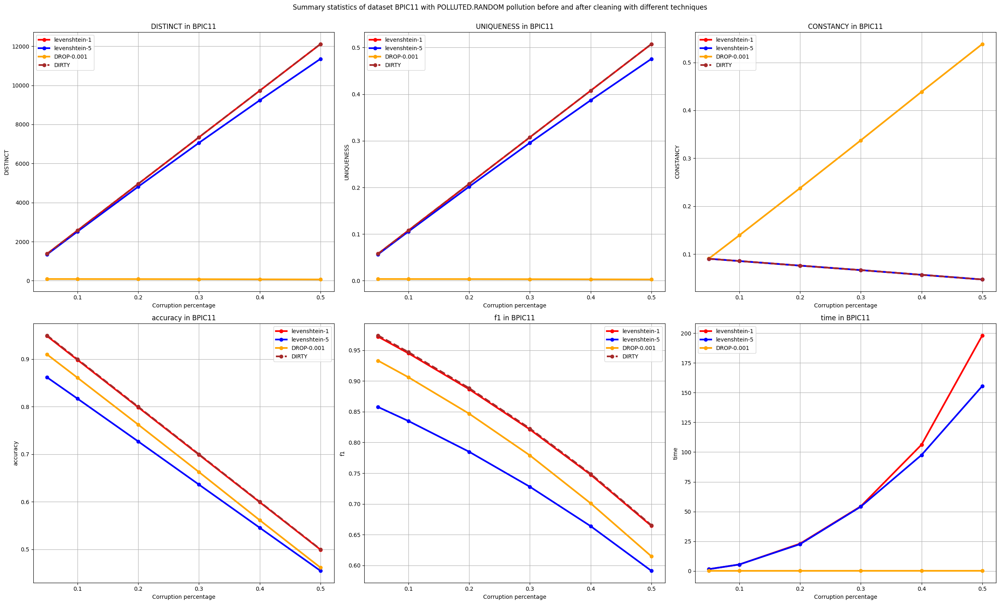

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="POLLUTED.RANDOM", dataset="BPIC11")

# EVALUATION

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}_uncleaned_EVALUATION_avg.pkl', 'rb') as f:
  eval_dirty_scores = pickle.load(f)

with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pkl', 'rb') as f:
  eval_clean_score ={"CLEAN":pickle.load(f)}
  eval_dirty_scores["CLEAN"] = eval_clean_score["CLEAN"]

eval_cleaned_scores = []
for technique in techniques:
  with open(f'./{dataset}/{dataset}/{dataset}_CLEANED-{technique}_EVALUATION_avg.pkl', 'rb') as f:
    eval_cleaned_scores.append(pickle.load(f))

with open(f'./{dataset}/{dataset}/{dataset}_empty_NAN_EVALUATION_avg.pkl', 'rb') as f:
    eval_cleaned_scores.append(pickle.load(f))

## By cleaning technique

### Levenshtein-1

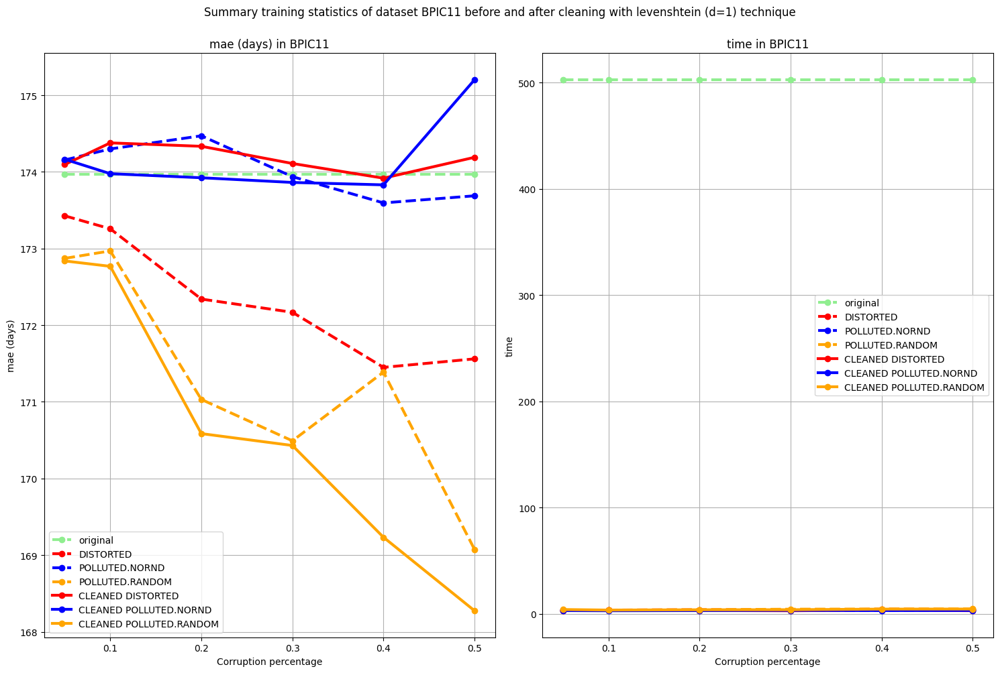

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[0], cleaning_type="levenshtein", d=1, dataset="BPIC11")

###Levenshtein-5

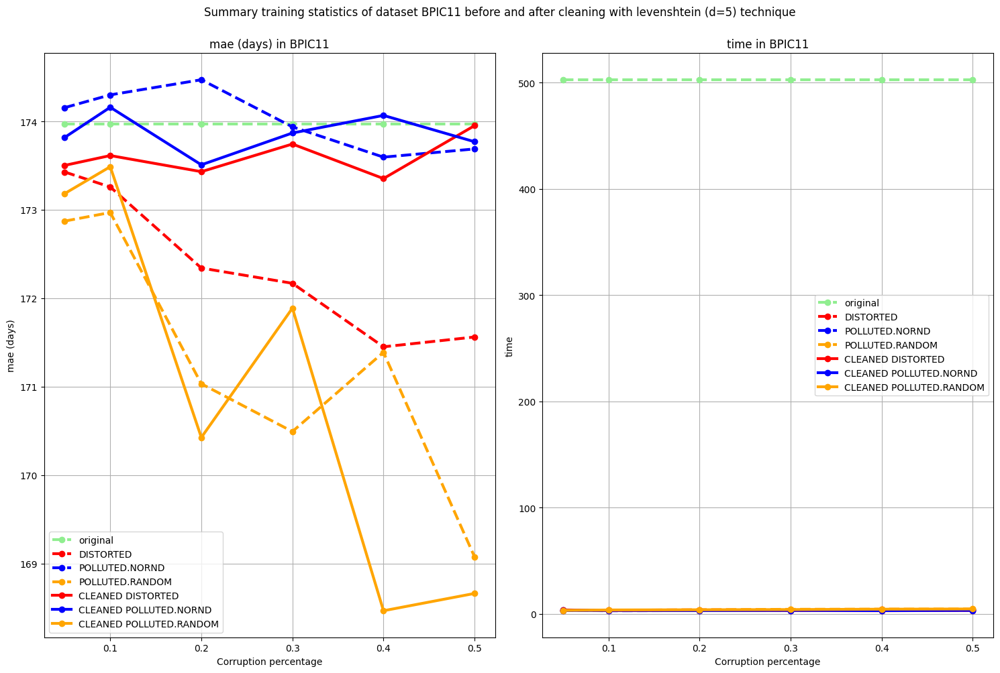

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[1], cleaning_type="levenshtein", d=5, dataset="BPIC11")

### DROP-0.001

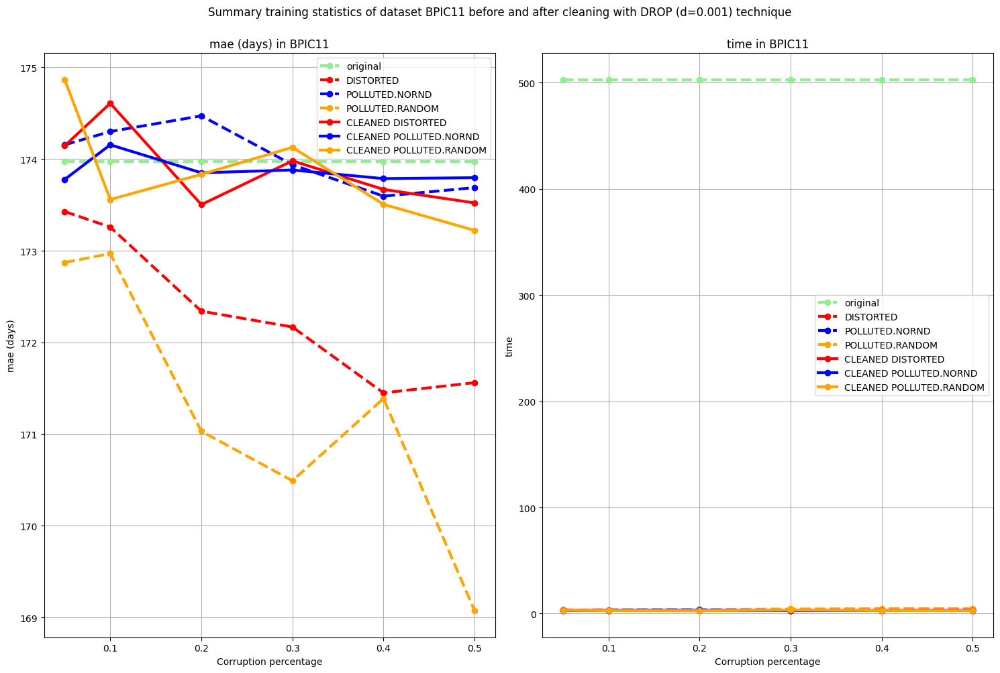

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[2], cleaning_type="DROP", d=0.001, dataset="BPIC11")

### DROP_DELETE-0.001

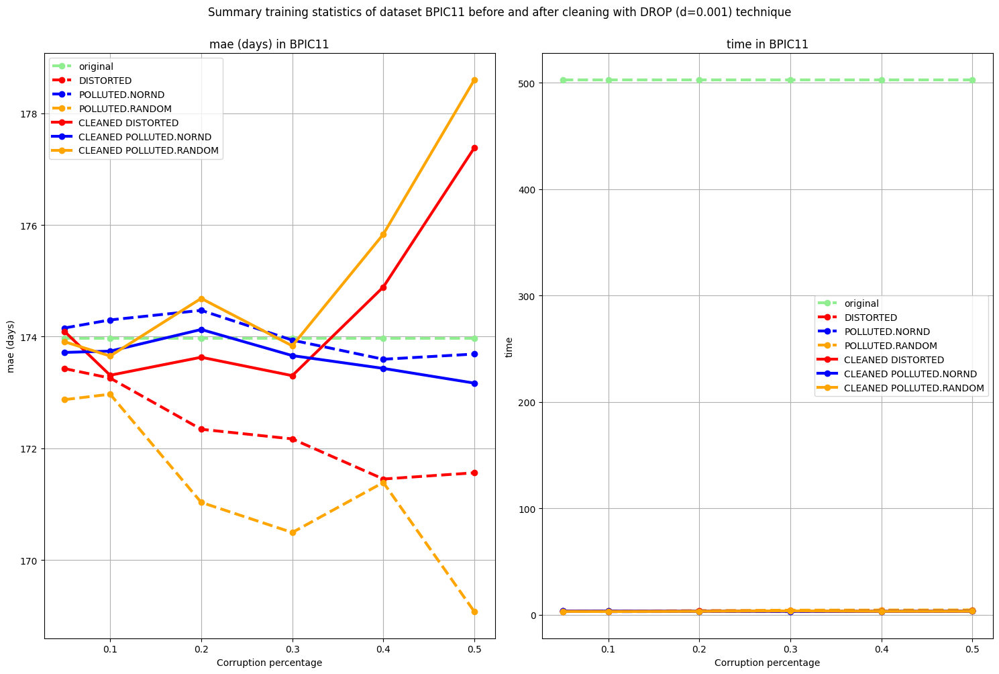

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[3], cleaning_type="DROP", d=0.001, dataset="BPIC11")

##By pollution type

### DISTORTED

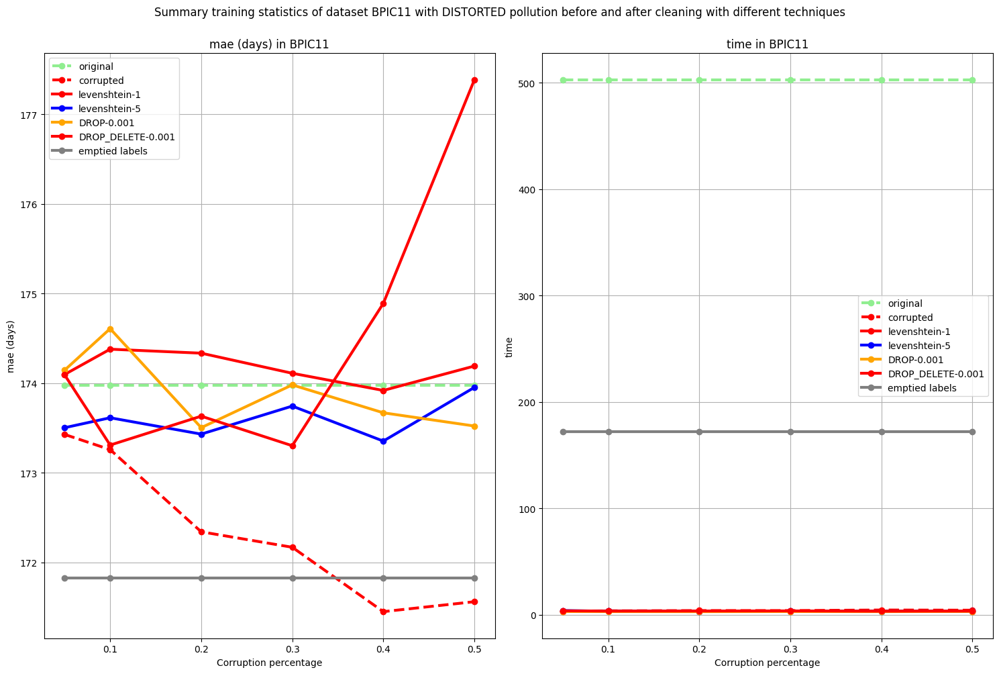

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="DISTORTED", dataset="BPIC11")

### POLLUTED.NORND

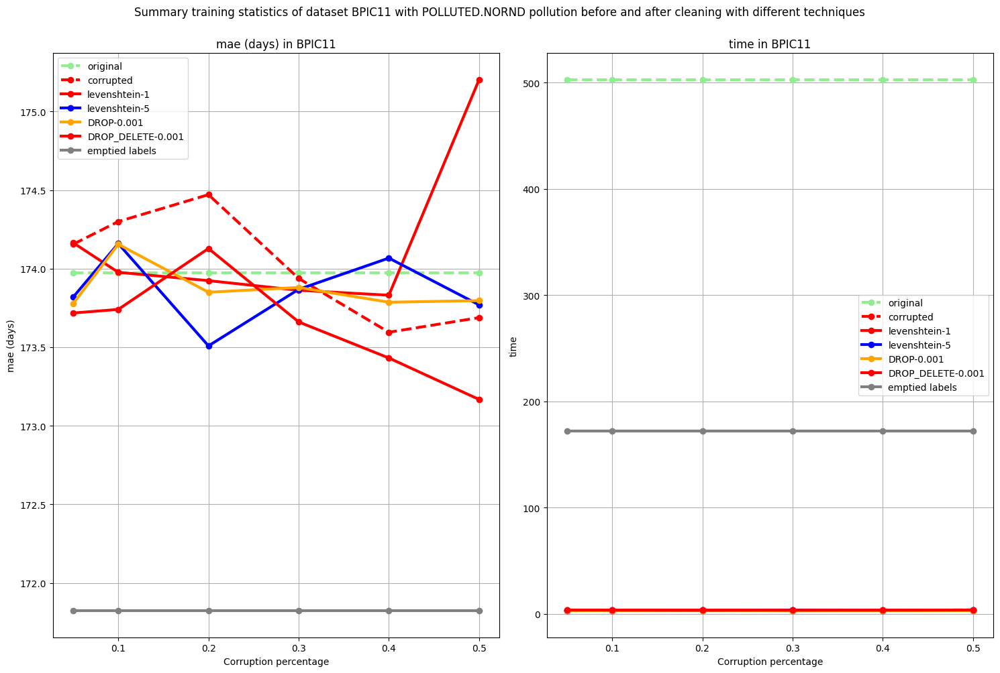

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="POLLUTED.NORND", dataset="BPIC11")

###POLLUTED.RANDOM

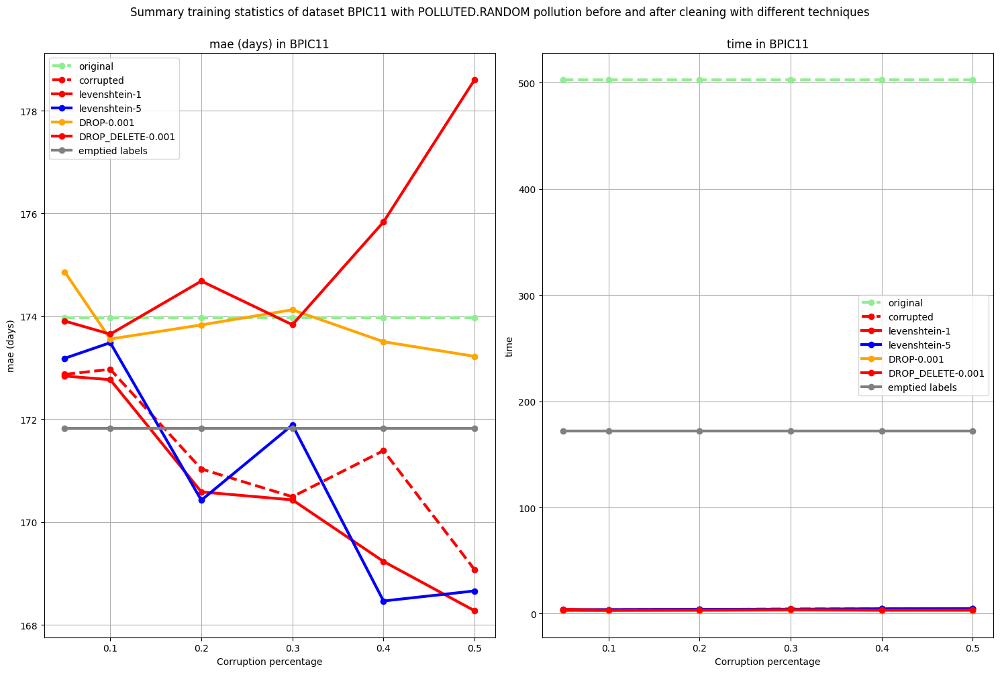

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="POLLUTED.RANDOM", dataset="BPIC11")

# BPIC15

In [ ]:
dataset = "BPIC15_1_f2"

In [ ]:
time_spread(dataset)

# CLEANING

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pickle', 'rb') as f:
  ref = pickle.load(f)
scores = []
for technique in techniques:
  with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_avg.pickle', 'rb') as f:
    scores.append(pickle.load(f))

## By cleaning technique

### Levenshtein-1

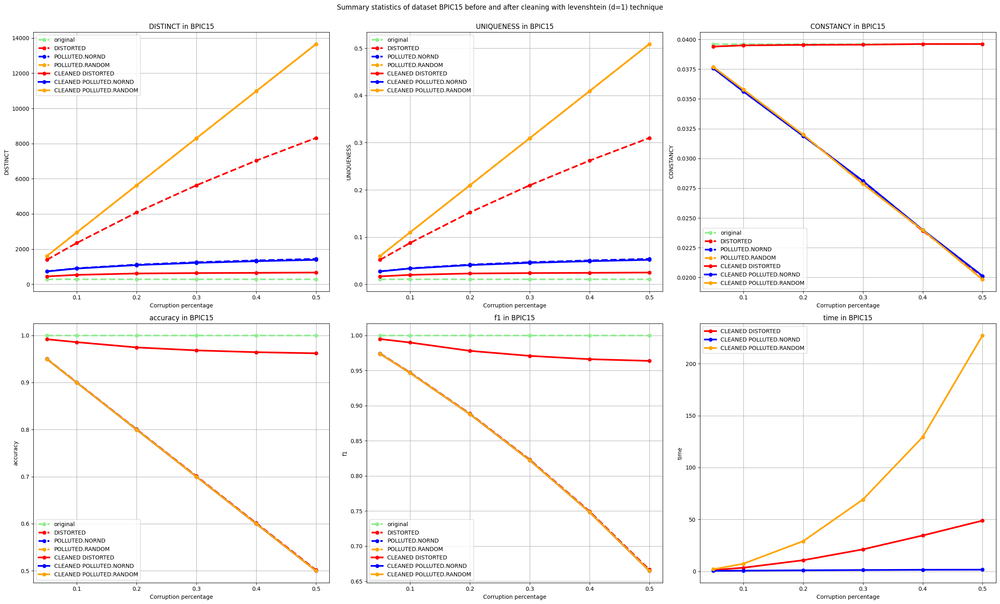

In [ ]:
summary_stats_plot(metrics_time, ref, scores[0], cleaning_type="levenshtein", d=1, dataset="BPIC15")

###Levenshtein-5

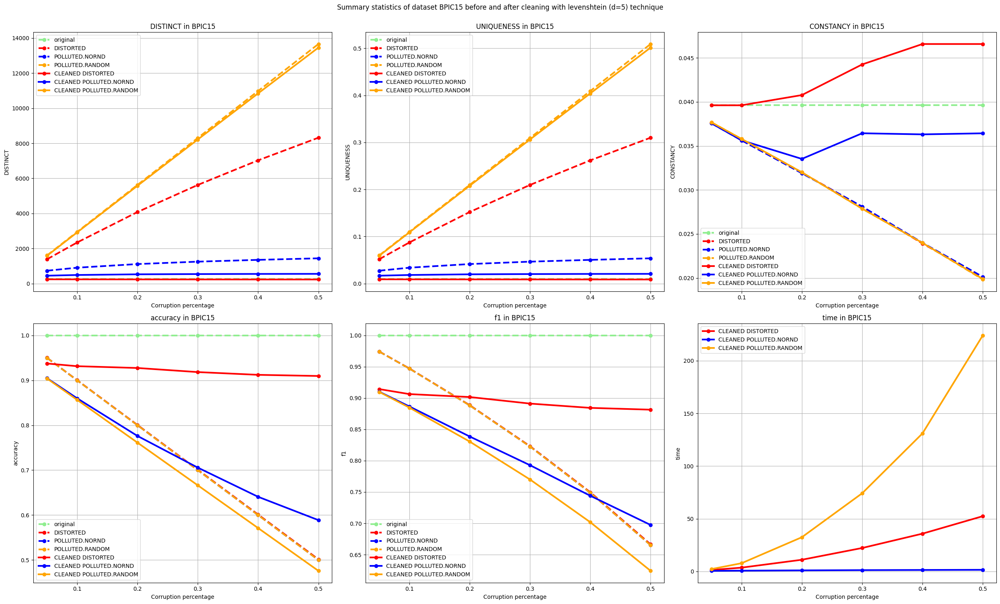

In [ ]:
summary_stats_plot(metrics_time, ref ,scores[1], cleaning_type="levenshtein", d=5, dataset="BPIC15")

### DROP-0.001

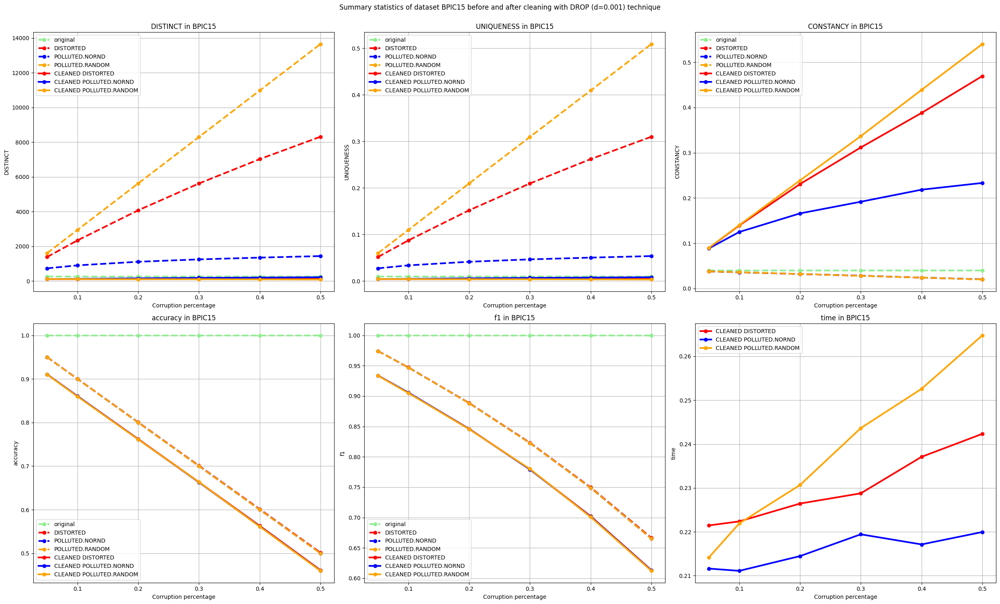

In [ ]:
summary_stats_plot(metrics_time, ref, scores[2], cleaning_type="DROP", d=0.001, dataset="BPIC15")

##By pollution type

### DISTORTED

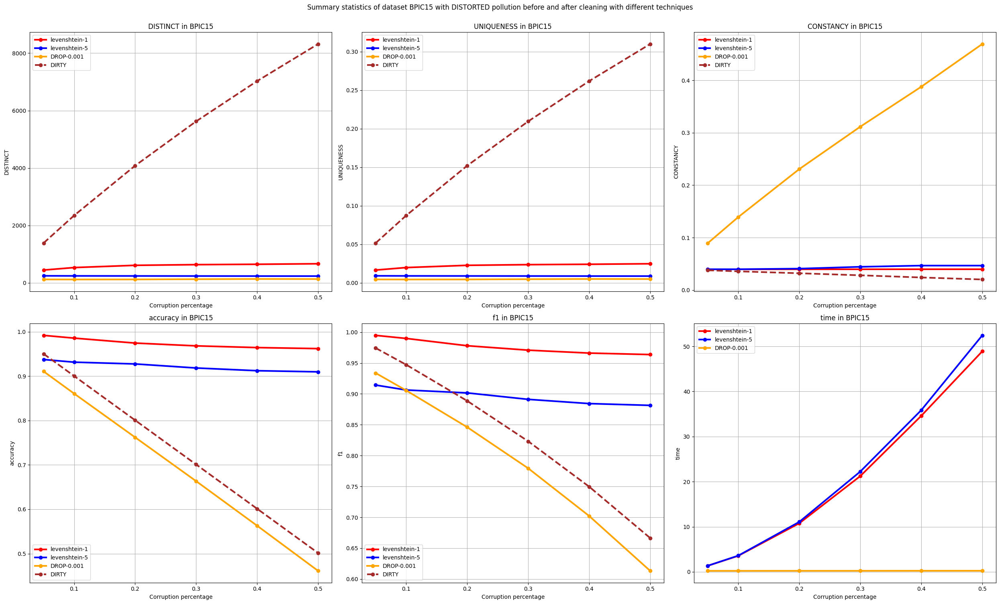

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="DISTORTED", dataset="BPIC15")

### POLLUTED.NORND

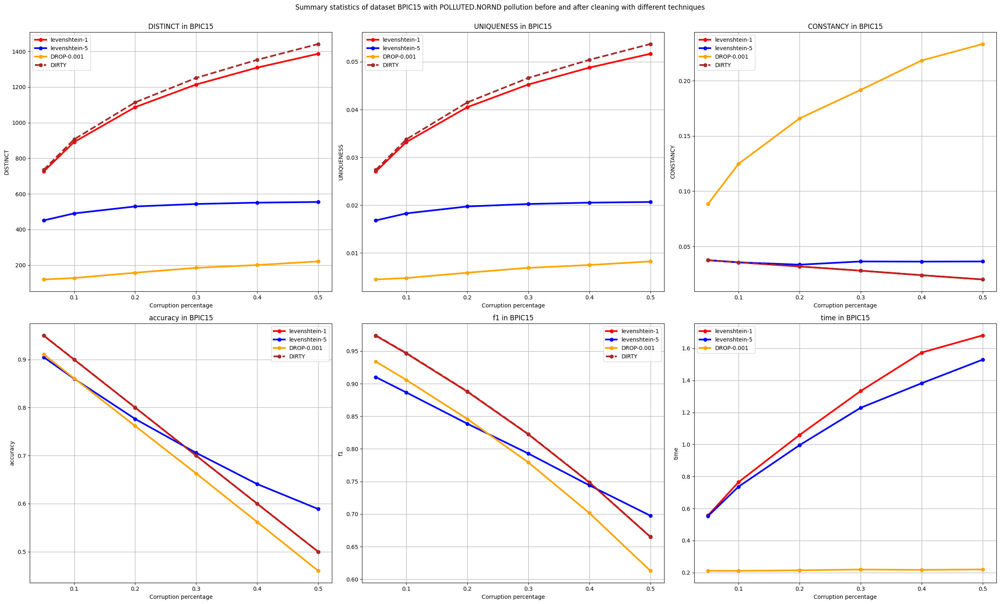

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="POLLUTED.NORND", dataset="BPIC15")

###POLLUTED.RANDOM

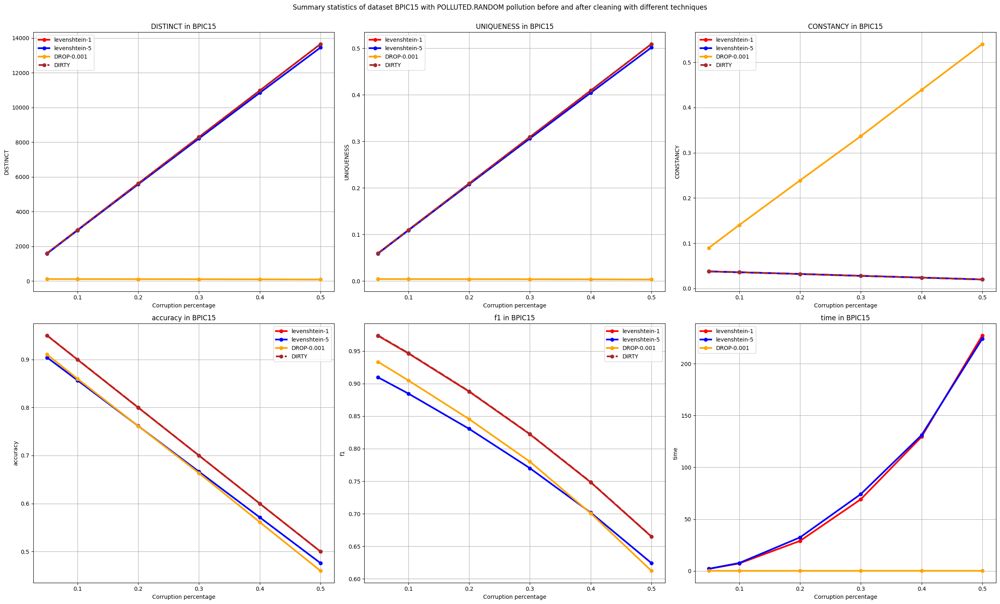

In [ ]:
summary_stats_plot_by_pollution(metrics_time, ref, scores, pollution_type="POLLUTED.RANDOM", dataset="BPIC15")

# EVALUATION

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}_uncleaned_EVALUATION_avg.pkl', 'rb') as f:
  eval_dirty_scores = pickle.load(f)

with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pkl', 'rb') as f:
  eval_clean_score ={"CLEAN":pickle.load(f)}
  eval_dirty_scores["CLEAN"] = eval_clean_score["CLEAN"]

eval_cleaned_scores = []
for technique in techniques:
  with open(f'./{dataset}/{dataset}/{dataset}_CLEANED-{technique}_EVALUATION_avg.pkl', 'rb') as f:
    eval_cleaned_scores.append(pickle.load(f))

with open(f'./{dataset}/{dataset}/{dataset}_empty_NAN_EVALUATION_avg.pkl', 'rb') as f:
    eval_cleaned_scores.append(pickle.load(f))

## By cleaning technique

### Levenshtein-1

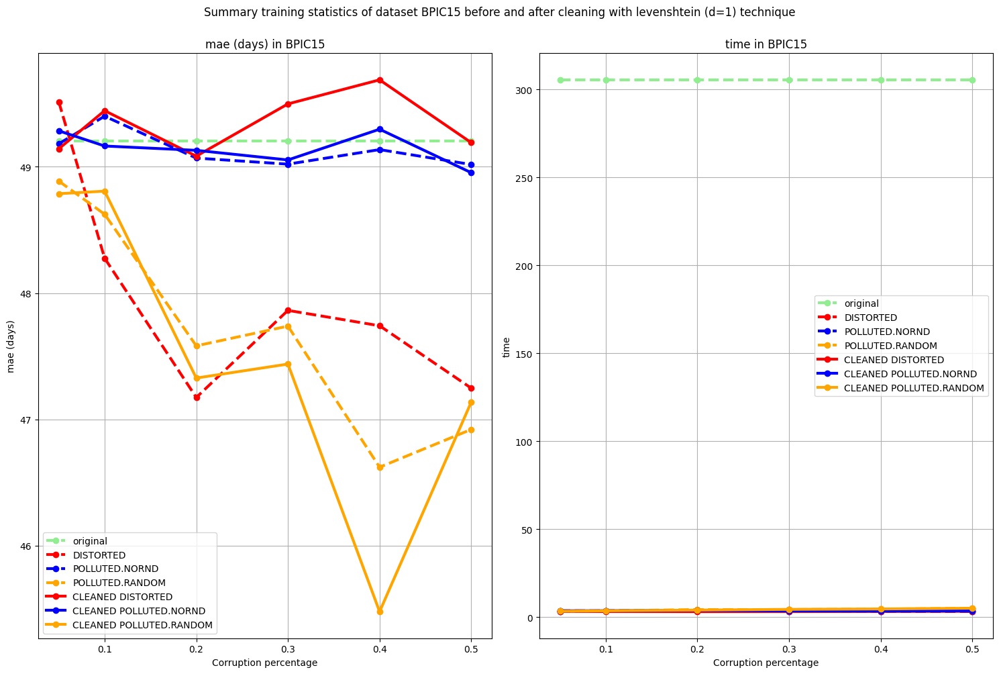

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[0], cleaning_type="levenshtein", d=1, dataset="BPIC15")

###Levenshtein-5

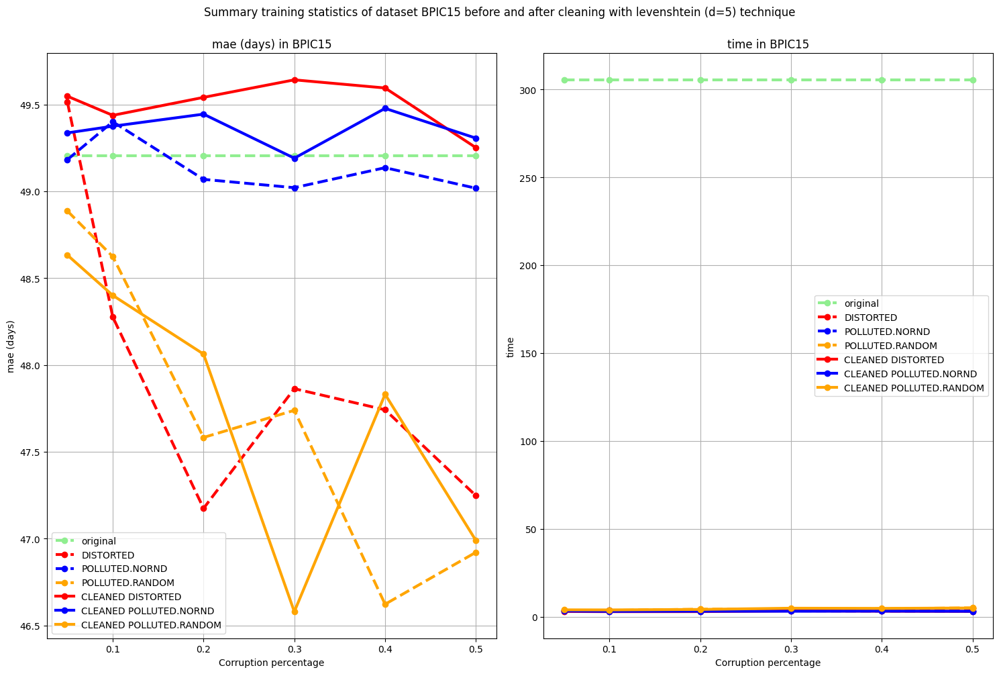

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[1], cleaning_type="levenshtein", d=5, dataset="BPIC15")

### DROP-0.001

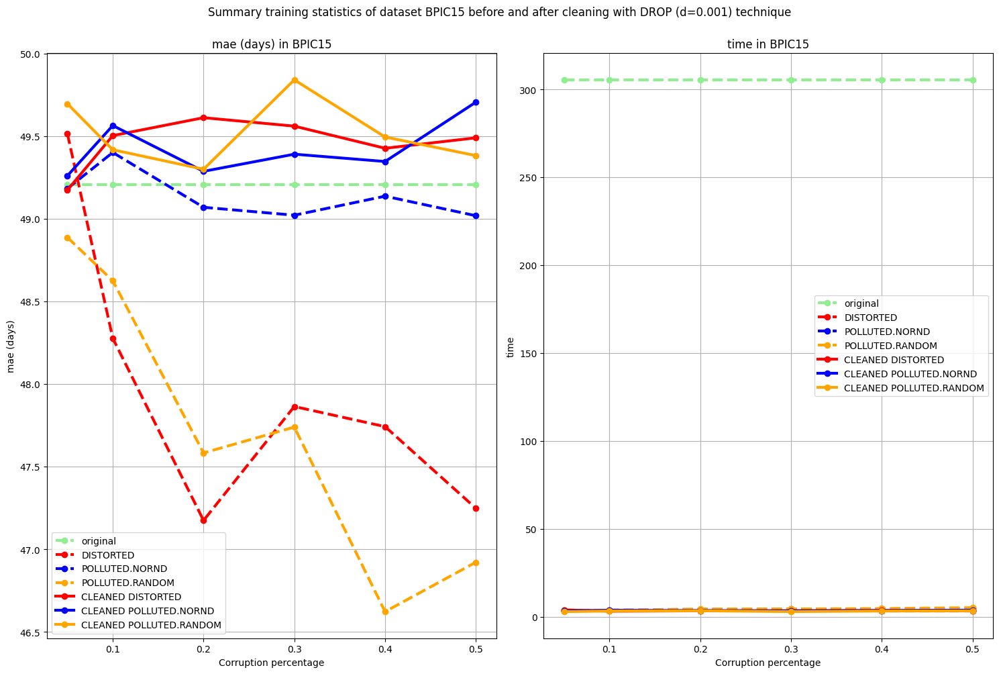

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[2], cleaning_type="DROP", d=0.001, dataset="BPIC15")

### DROP_DELETE-0.001

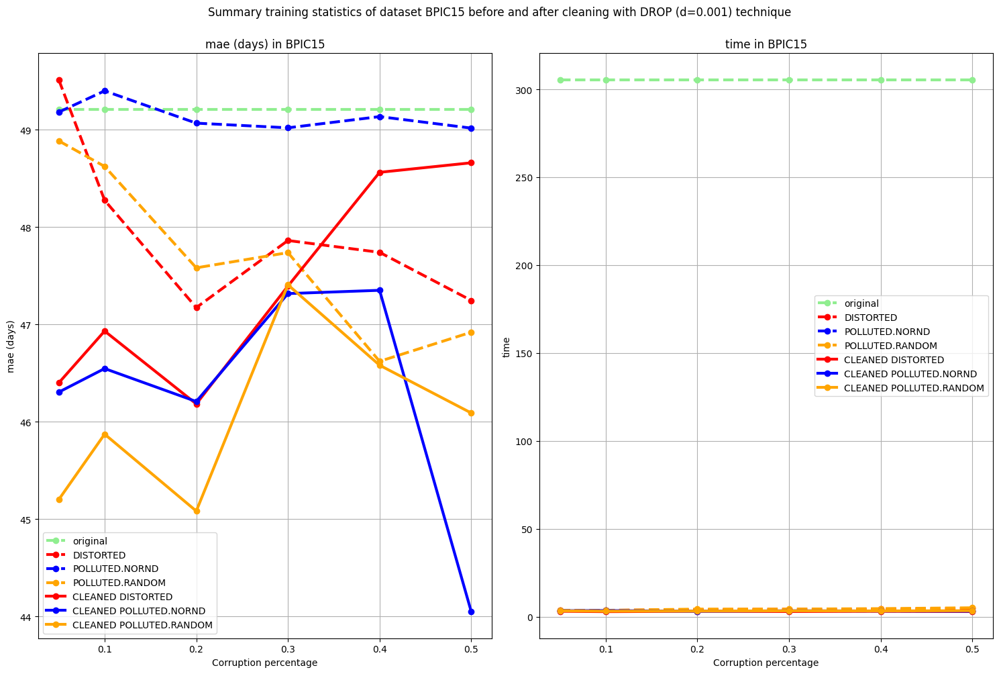

In [ ]:
summary_stats_plot_eval(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores[3], cleaning_type="DROP", d=0.001, dataset="BPIC15")

##By pollution type

### DISTORTED

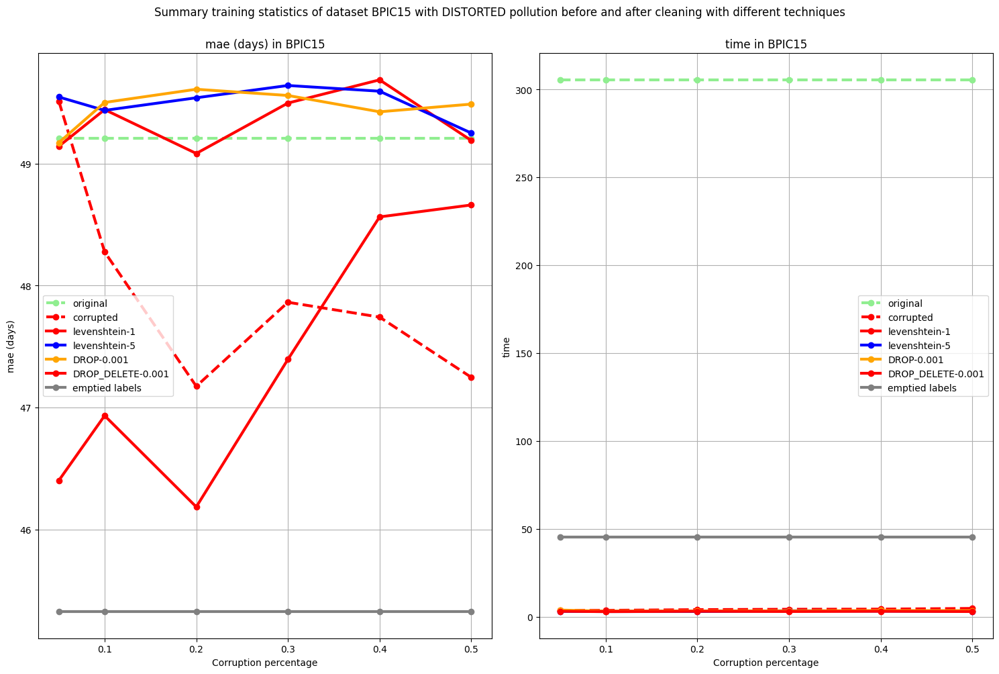

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="DISTORTED", dataset="BPIC15")

### POLLUTED.NORND

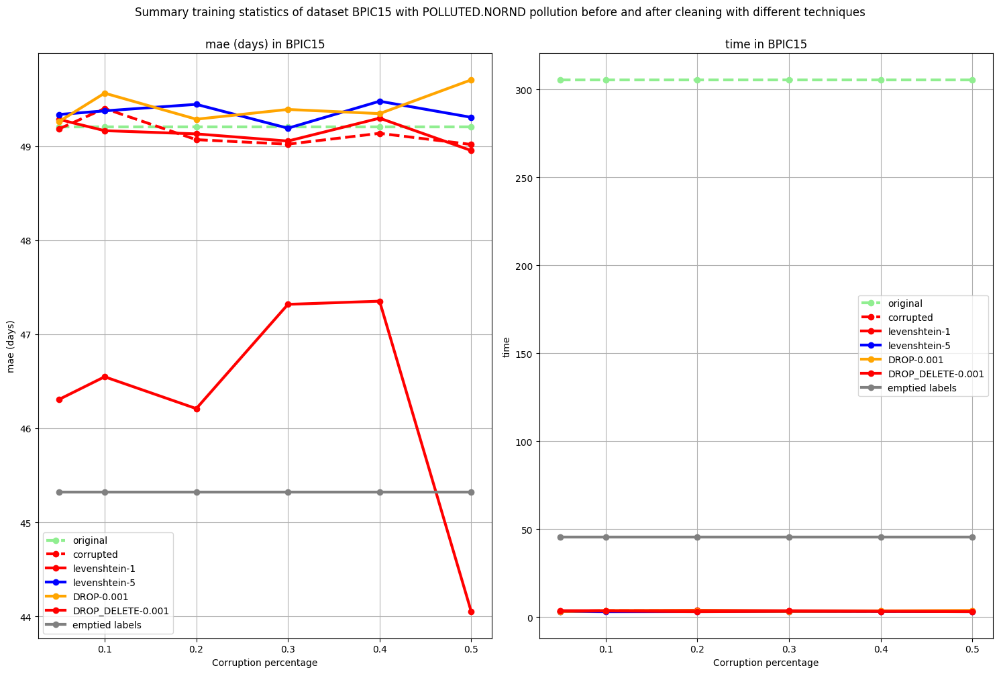

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="POLLUTED.NORND", dataset="BPIC15")

###POLLUTED.RANDOM

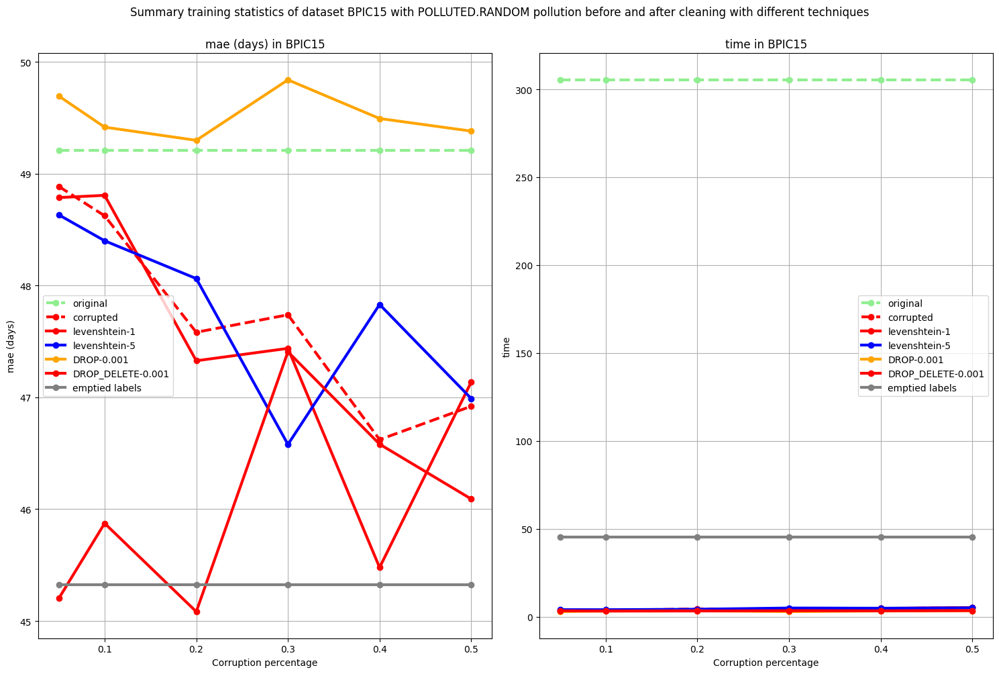

In [ ]:
summary_stats_plot_eval_by_pollution(metrics_eval, eval_clean_score, eval_dirty_scores, eval_cleaned_scores, pollution_type="POLLUTED.RANDOM", dataset="BPIC15")

# Credit

In [ ]:
dataset = "Credit"
pollution_types = ["DISTORTED-activity","SYNONYM", "HOMONYM"]
techniques = ['PATTERNER']
metrics = ["DISTINCT", "UNIQUENESS", "CONSTANCY", "accuracy", "precision", "recall", "f1", "time"]

In [ ]:
time_spread(dataset)

# CLEANING

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pickle', 'rb') as f:
  ref = pickle.load(f)
scores = []
with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_DISTORTED_avg.pickle', 'rb') as f:
  scores_dist = pickle.load(f)
with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_SYNONYMOUS_avg.pickle', 'rb') as f:
  scores_syno = pickle.load(f)
with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_HOMONYMOUS_avg.pickle', 'rb') as f:
  scores_homo = pickle.load(f)
scores = dict(zip(pollution_types, [scores_dist, scores_syno, scores_homo]))

## By cleaning technique

### Patterns comparisons

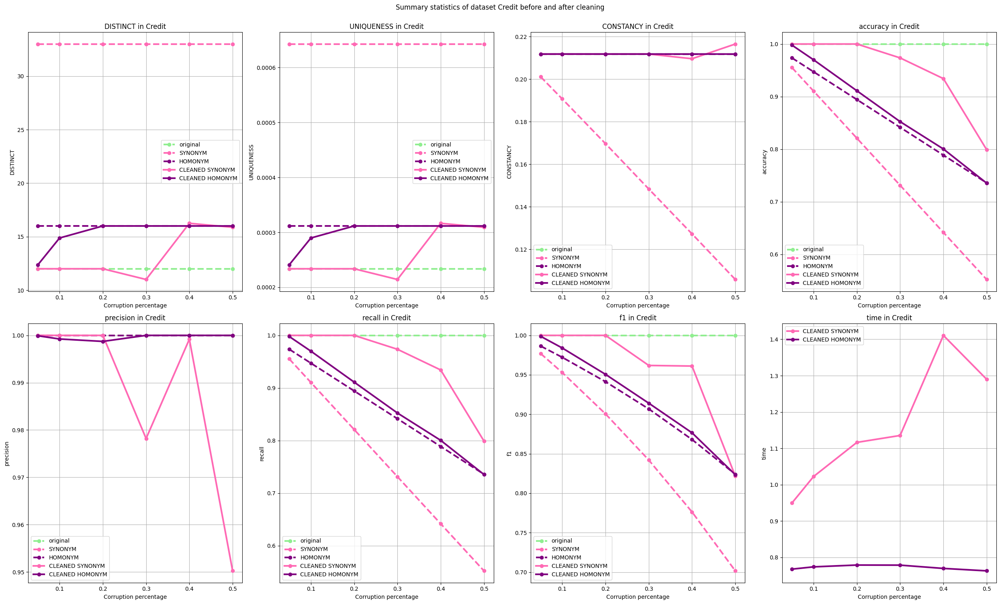

In [ ]:
#colors = ["brown", "hotpink", "purple"] #TODO: find better colors

colors = ["hotpink", "purple"] #TODO: find better colors


fig, axes = plt.subplots(2, 4, figsize=(25, 15)) #tentative
axes = axes.flatten()

x = percentages
j=0
for i, metric in enumerate(metrics):

  if metric!="time": # first part only for uncleaned datasets, which do not have an associated cleaning time
    y = [ref["CLEAN"][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')
    for pollution_type in pollution_types: # base datasets
      if pollution_type!="DISTORTED-activity": # temp
        y = [ref[pollution_type][percentage][metric] for percentage in percentages]
        axes[i].plot(x, y, linestyle="dashed", marker="o", label=pollution_type, linewidth=3, color=colors[j%len(colors)])
        j+=1

  for pollution_type in pollution_types: # cleaned datasets
    if pollution_type!="DISTORTED-activity": # temp
      y = [scores[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="-", marker="o", label='CLEANED ' + pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

  axes[i].set_xlabel("Corruption percentage")
  axes[i].set_ylabel(metric)
  axes[i].set_title(f"{metric} in {dataset}")
  axes[i].legend()
  axes[i].grid(True)

fig.suptitle(f"Summary statistics of dataset {dataset} before and after cleaning", y=1)
fig.tight_layout()
fig.show()

# Pub

In [ ]:
dataset = "Pub"
pollution_types = ["SYNONYM"]
techniques = ['PATTERNER']
metrics = ["DISTINCT", "UNIQUENESS", "CONSTANCY", "accuracy", "precision", "recall", "f1", "time"]

In [ ]:
time_spread(dataset)

# CLEANING

In [ ]:
with open(f'./{dataset}/{dataset}/{dataset}-REF_scores_matrix_avg.pickle', 'rb') as f:
  ref = pickle.load(f)
scores = []
with open(f'./{dataset}/{dataset}/{dataset}_scores_matrix_{technique}_SYNONYMOUS_avg.pickle', 'rb') as f:
  scores_syno = pickle.load(f)
scores = dict(zip(pollution_types, [scores_syno]))

## By cleaning technique

### Patterns comparisons

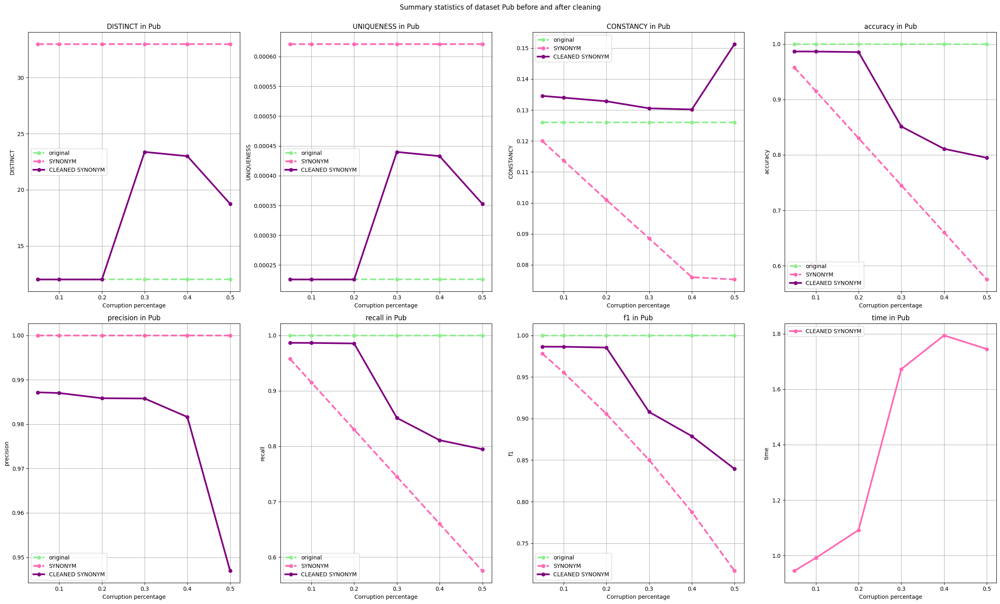

In [ ]:
colors = ["hotpink", "purple"] #TODO: find better colors

fig, axes = plt.subplots(2, 4, figsize=(25, 15)) #tentative
axes = axes.flatten()

x = percentages
j=0
for i, metric in enumerate(metrics):

  if metric!="time": # first part only for uncleaned datasets, which do not have an associated cleaning time
    y = [ref["CLEAN"][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="dashed", marker="o", label="original", linewidth=3, color='lightgreen')
    for pollution_type in pollution_types: # base datasets
      y = [ref[pollution_type][percentage][metric] for percentage in percentages]
      axes[i].plot(x, y, linestyle="dashed", marker="o", label=pollution_type, linewidth=3, color=colors[j%len(colors)])
      j+=1

  for pollution_type in pollution_types: # cleaned datasets
    y = [scores[pollution_type][percentage][metric] for percentage in percentages]
    axes[i].plot(x, y, linestyle="-", marker="o", label='CLEANED ' + pollution_type, linewidth=3, color=colors[j%len(colors)])
    j+=1

  axes[i].set_xlabel("Corruption percentage")
  axes[i].set_ylabel(metric)
  axes[i].set_title(f"{metric} in {dataset}")
  axes[i].legend()
  axes[i].grid(True)

fig.suptitle(f"Summary statistics of dataset {dataset} before and after cleaning", y=1)
fig.tight_layout()
fig.show()